# W203 Lab 1: Hypothesis Testing


## Import Packages

In [1]:
import numpy as np
import pandas as pd
import scipy as sp
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import wooldridge
from statistics import mean, stdev
from PIL import Image
%matplotlib inline

## Part 1 Foundational Exercises -- Applied Practice

### 1a sample answer. Find type 1 error

In [2]:
one_a = Image.open('images/Applied_Practice_1a.jpg')

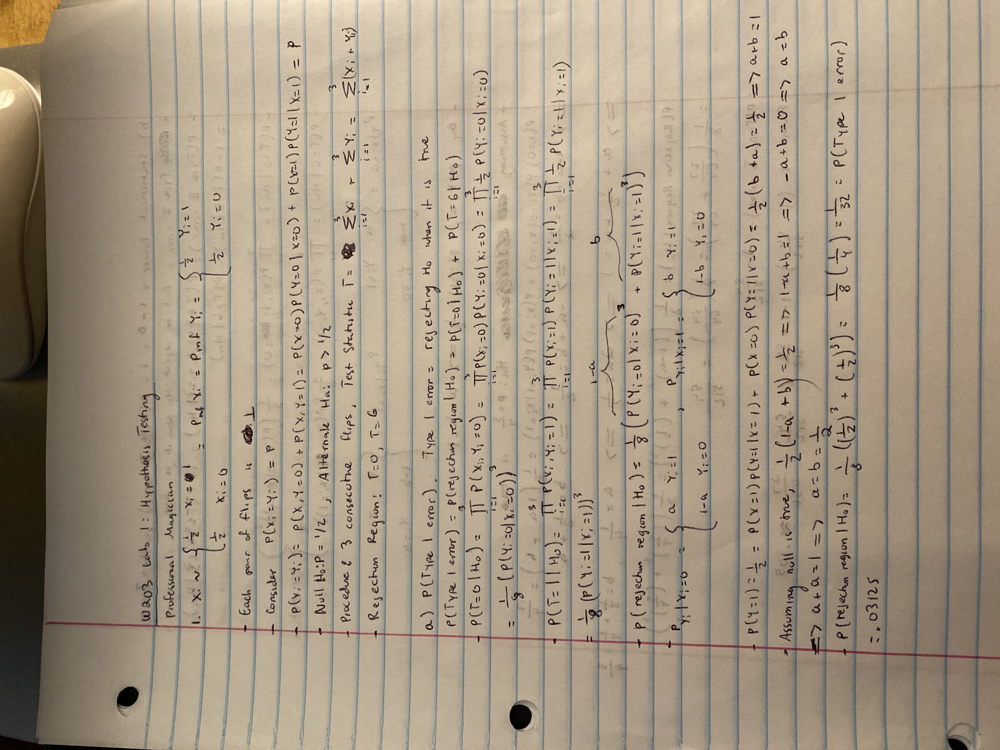

In [3]:
one_a

### 1b sample answer. Calculate Statistical Power

In [4]:
one_b = Image.open('images/Applied_Practice_1b.jpg')

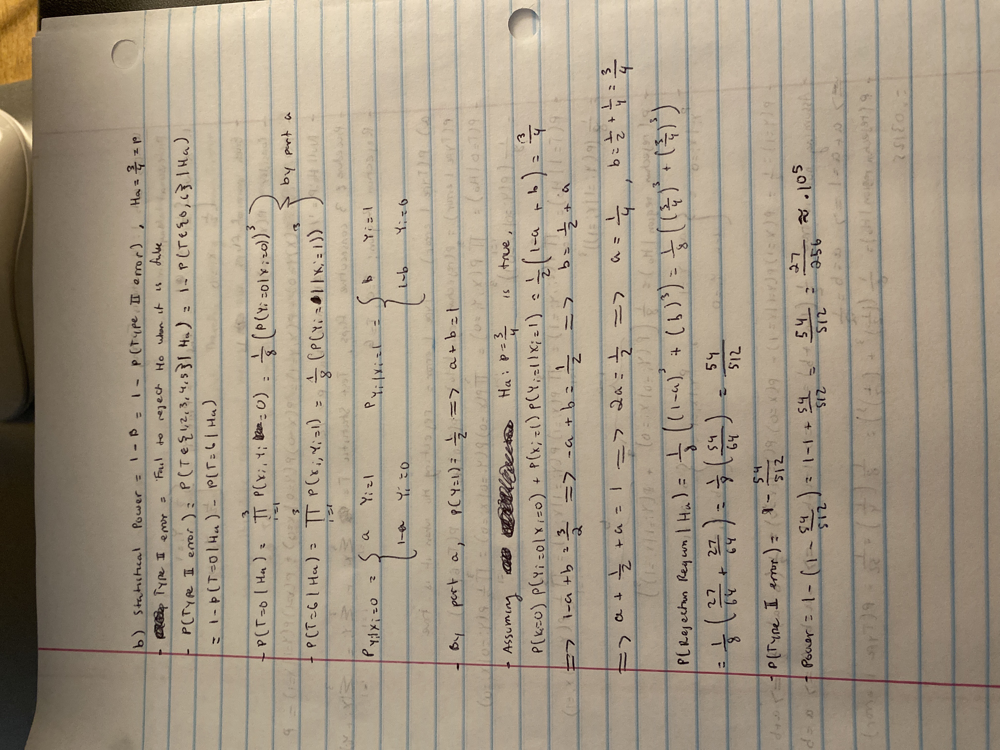

In [5]:
one_b

### 2 sample answer.

A paired t-test specifically tests for the mean difference between two **metric** variables. Because the paired sample in this case is ordinal, calculating the distance/difference between values on a Likert Scale would result in a non-sensical value. Specifically, the interval between two adjacent points on the scale may not be equal to the interval between a different pair of adjacent points on the scale, therefore defining an **ordinal rather than metric** value. Taking a mean/stdev amongst these categorical differences means we will pass non-sensical values into our computed test statistic. This would render results ultimately uninterpretable.

## Part 1 Foundational Exercises -- Test Assumptions

### 1 sample answer. 
two-sample t-test assumptions:  
1. independent samples
2. metric data
3. population is approximately normal, unless sample size is large such that CLT applies
4. similar variances

In [6]:
happiness_data = pd.read_csv('datasets/happiness_WHR.csv') # Read in data
happiness_data

,Country name,year,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect
0,Afghanistan,2019,2.375,7.697,0.420,52.4,0.394,-0.108,0.924,0.351,0.502
1,Albania,2019,4.995,9.544,0.686,69.0,0.777,-0.099,0.914,0.681,0.274
2,Algeria,2019,4.745,9.337,0.803,66.1,0.385,0.005,0.741,0.585,0.215
3,Argentina,2019,6.086,10.000,0.896,69.0,0.817,-0.211,0.830,0.826,0.319
4,Armenia,2019,5.488,9.522,0.782,67.2,0.844,-0.172,0.583,0.598,0.430
...,...,...,...,...,...,...,...,...,...,...,...
234,United States,2020,7.028,11.001,0.937,68.1,0.850,0.034,0.678,0.787,0.295
235,Uruguay,2020,6.310,9.937,0.921,69.2,0.908,-0.084,0.491,0.807,0.265
236,Venezuela,2020,4.574,NaN,0.805,66.9,0.612,NaN,0.811,0.722,0.396
237,Zambia,2020,4.838,8.117,0.767,56.3,0.750,0.056,0.810,0.691,0.345


In [7]:
happiness_data = happiness_data[['Life Ladder','Log GDP per capita']] # Keep life ladder and GDP data
happiness_data

,Life Ladder,Log GDP per capita
0,2.375,7.697
1,4.995,9.544
2,4.745,9.337
3,6.086,10.000
4,5.488,9.522
...,...,...
234,7.028,11.001
235,6.310,9.937
236,4.574,NaN
237,4.838,8.117


In [8]:
happiness_data.dropna(inplace=True) # drop na values
happiness_data

<ipython-input-8-93c5236bb095>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  happiness_data.dropna(inplace=True) # drop na values


,Life Ladder,Log GDP per capita
0,2.375,7.697
1,4.995,9.544
2,4.745,9.337
3,6.086,10.000
4,5.488,9.522
...,...,...
233,6.798,10.626
234,7.028,11.001
235,6.310,9.937
237,4.838,8.117


In [9]:
mean_gdp = happiness_data['Log GDP per capita'].mean() #get average gdp
print(mean_gdp)

9.583836283185848


In [10]:
high_gdp = happiness_data[happiness_data['Log GDP per capita'] >= mean_gdp]
low_gdp = happiness_data[happiness_data['Log GDP per capita'] < mean_gdp]

In [11]:
high_gdp

,Life Ladder,Log GDP per capita
3,6.086,10.000
5,7.234,10.815
6,7.195,10.939
8,7.098,10.715
10,5.821,9.860
...,...,...
229,4.862,10.219
232,6.458,11.053
233,6.798,10.626
234,7.028,11.001


In [12]:
low_gdp

,Life Ladder,Log GDP per capita
0,2.375,7.697
1,4.995,9.544
2,4.745,9.337
4,5.488,9.522
7,5.173,9.575
...,...,...
228,4.731,9.231
230,4.641,7.684
231,5.270,9.428
237,4.838,8.117


In [13]:
print(stdev(high_gdp['Life Ladder'])) #high gdp life ladder sample stdev
print(stdev(low_gdp['Life Ladder'])) #low gdp life ladder sample stdev

0.8024287311624886
0.8158269374943389


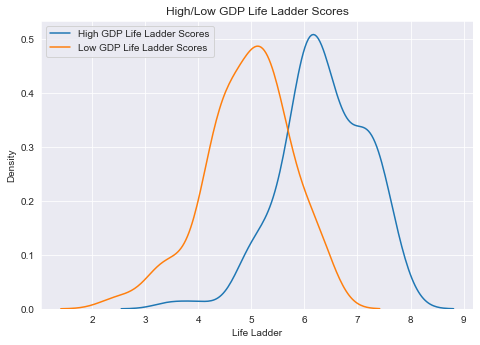

In [14]:
#Plot both high/low gdp life ladder scores
sns.set_style('darkgrid')
fig = plt.figure()
axes = fig.add_axes([0,0,1,1])
sns.kdeplot(high_gdp['Life Ladder'],label='High GDP Life Ladder Scores')
sns.kdeplot(low_gdp['Life Ladder'],label='Low GDP Life Ladder Scores')
axes.set_xlabel('Life Ladder')
axes.set_title('High/Low GDP Life Ladder Scores')
plt.legend()
plt.show()

Evaluation of Assumptions:
- This case meets the criteria of independent samples as the life ladder score for one country likelihood does not provide information regarding the life ladder score of another country
- This case meets the criteria of metric data as long as the assumption can be made that intervals between scores on the Cantril Ladder are equal (2 is the same distance from a 3 as it is from a 1, etc). This assumption would validate means being taken for each country.
- Both samples indicate potential deviations from normality, but with a sample size of 121 and 105 respectively for the high/low gdp groupings and data that does not indicate particularly strong skews, CLT would apply in this case resulting in the distributions of sample means being approximately normal
- Both samples have similar sample variances

**Missing context: are the intervals along the Cantril scale assumed to be equal**

### 2 sample answer.

Wilcoxon Rank Sum Test Assumptions:
- Responses are at least ordinal
- independent samples
- X,Y have similar distributions (shape, spread/variance) with only possible difference being the mean

In [15]:
legislators_data = pd.read_csv('datasets/legislators-current.csv') #read in data
legislators_data

,last_name,first_name,middle_name,suffix,nickname,full_name,birthday,gender,type,state,...,opensecrets_id,lis_id,fec_ids,cspan_id,govtrack_id,votesmart_id,ballotpedia_id,washington_post_id,icpsr_id,wikipedia_id
0,Brown,Sherrod,NaN,NaN,NaN,Sherrod Brown,1952-11-09,M,sen,OH,...,N00003535,S307,"H2OH13033,S6OH00163",5051.0,400050,27018.0,Sherrod Brown,NaN,29389.0,Sherrod Brown
1,Cantwell,Maria,NaN,NaN,NaN,Maria Cantwell,1958-10-13,F,sen,WA,...,N00007836,S275,"S8WA00194,H2WA01054",26137.0,300018,27122.0,Maria Cantwell,NaN,39310.0,Maria Cantwell
2,Cardin,Benjamin,L.,NaN,NaN,Benjamin L. Cardin,1943-10-05,M,sen,MD,...,N00001955,S308,"H6MD03177,S6MD03177",4004.0,400064,26888.0,Ben Cardin,NaN,15408.0,Ben Cardin
3,Carper,Thomas,Richard,NaN,NaN,Thomas R. Carper,1947-01-23,M,sen,DE,...,N00012508,S277,S8DE00079,663.0,300019,22421.0,Tom Carper,NaN,15015.0,Tom Carper
4,Casey,Robert,P.,Jr.,Bob,"Robert P. Casey, Jr.",1960-04-13,M,sen,PA,...,N00027503,S309,S6PA00217,47036.0,412246,2541.0,"Bob Casey, Jr.",NaN,40703.0,Bob Casey Jr.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
533,Tenney,Claudia,NaN,NaN,NaN,Claudia Tenney,1961-02-04,F,rep,NY,...,N00036351,NaN,H4NY22051,103481.0,412720,127668.0,Claudia Tenney,NaN,21749.0,Claudia Tenney
534,Letlow,Julia,NaN,NaN,NaN,Julia Letlow,1981-03-16,F,rep,LA,...,N00047972,NaN,H2LA05126,NaN,456859,NaN,Julia Letlow,NaN,NaN,Julia Letlow
535,Carter,Troy,Anthony,NaN,NaN,Troy A. Carter,1963-10-26,M,rep,LA,...,N00025766,NaN,H2LA02149,NaN,456860,NaN,Troy Carter,NaN,NaN,Troy Carter (politician)
536,Stansbury,Melanie,Ann,NaN,NaN,Melanie A. Stansbury,1979-01-31,F,rep,NM,...,N00047871,NaN,H2NM01144,NaN,456861,NaN,Melanie Ann Stansbury,NaN,NaN,Melanie Stansbury


In [16]:
legislators_data.columns #print columns to ID which columns to keep

Index(['last_name', 'first_name', 'middle_name', 'suffix', 'nickname',
       'full_name', 'birthday', 'gender', 'type', 'state', 'district',
       'senate_class', 'party', 'url', 'address', 'phone', 'contact_form',
       'rss_url', 'twitter', 'facebook', 'youtube', 'youtube_id',
       'bioguide_id', 'thomas_id', 'opensecrets_id', 'lis_id', 'fec_ids',
       'cspan_id', 'govtrack_id', 'votesmart_id', 'ballotpedia_id',
       'washington_post_id', 'icpsr_id', 'wikipedia_id'],
      dtype='object')

In [17]:
legislators_data = legislators_data[['birthday','party','type']] # keep birthday, party, and type
legislators_data['birthday'] = pd.to_datetime(legislators_data['birthday']) # store birthday as date instead of string
legislators_data

<ipython-input-17-548882af888a>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  legislators_data['birthday'] = pd.to_datetime(legislators_data['birthday']) # store birthday as date instead of string


,birthday,party,type
0,1952-11-09,Democrat,sen
1,1958-10-13,Democrat,sen
2,1943-10-05,Democrat,sen
3,1947-01-23,Democrat,sen
4,1960-04-13,Democrat,sen
...,...,...,...
533,1961-02-04,Republican,rep
534,1981-03-16,Republican,rep
535,1963-10-26,Democrat,rep
536,1979-01-31,Democrat,rep


In [18]:
legislators_data['age'] = legislators_data['birthday'].apply(lambda x:(datetime.datetime.now()-x).days/365.24) #age of legislators
legislators_data

<ipython-input-18-f276fd972357>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  legislators_data['age'] = legislators_data['birthday'].apply(lambda x:(datetime.datetime.now()-x).days/365.24) #age of legislators


,birthday,party,type,age
0,1952-11-09,Democrat,sen,68.921805
1,1958-10-13,Democrat,sen,62.996934
2,1943-10-05,Democrat,sen,78.019932
3,1947-01-23,Democrat,sen,74.717994
4,1960-04-13,Democrat,sen,61.496550
...,...,...,...,...
533,1961-02-04,Republican,rep,60.683386
534,1981-03-16,Republican,rep,40.573322
535,1963-10-26,Democrat,rep,57.961888
536,1979-01-31,Democrat,rep,42.695214


In [19]:
dem_sen = legislators_data[(legislators_data['party'] == 'Democrat') & (legislators_data['type'] == 'sen')] #democratic senators

In [20]:
dem_sen = dem_sen[['party','age']]
dem_sen

,party,age
0,Democrat,68.921805
1,Democrat,62.996934
2,Democrat,78.019932
3,Democrat,74.717994
4,Democrat,61.496550
5,Democrat,88.306319
6,Democrat,61.381557
7,Democrat,67.777352
9,Democrat,71.454386
10,Democrat,65.140729


In [21]:
rep_sen = legislators_data[(legislators_data['party'] == 'Republican') & (legislators_data['type'] == 'sen')] #republican senators

In [22]:
rep_sen = rep_sen[['party','age']]
rep_sen

,party,age
12,Republican,69.225715
13,Republican,70.271602
14,Republican,68.845143
15,Republican,69.691162
17,Republican,66.260541
18,Republican,86.901763
19,Republican,79.640784
22,Republican,78.444311
34,Republican,69.348921
37,Republican,71.752820


In [23]:
#print sample sizes
print(len(dem_sen))
print(len(rep_sen))

48
50


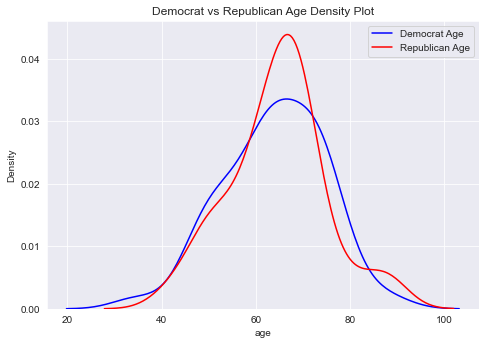

In [24]:
# plot age density party lines
fig = plt.figure()
axes = fig.add_axes([0,0,1,1])
sns.kdeplot(dem_sen['age'],color = 'blue',label='Democrat Age')
sns.kdeplot(rep_sen['age'], color = 'red',label='Republican Age')
axes.set_title('Democrat vs Republican Age Density Plot')
plt.legend()
plt.show()

In [25]:
print(stdev(dem_sen['age'])) #sample stdev of democrat age
print(stdev(rep_sen['age'])) #sample stdev of republican age

10.719337341283765
10.137240375076683


Evaluation of Assumptions
- This case meets the assumption of at least ordinal data given that age is a metric variable
- This case meets the assumption of independent samples due to the age of one senator not informing on the age of another
- As seen with the kdeplot and the sample stdev calculations, there is some minor deviations between republican vs democrat age distribution but overall they carry similar shapes and spread

### 3 sample answer.

Assumptions for Wilcoxon Signed Rank:
- Responses are at least ordinal
- Independent samples
- Naturally paired data that is measured on the same scale
- Distribution of differences is approximately symmetric

In [26]:
wine_data = wooldridge.data('wine') #import wine data from wooldridge library
wine_data

,country,alcohol,deaths,heart,liver
0,Australia,2.5,785,211,15.300000
1,Austria,3.9,863,167,45.599998
2,Belg/Lux,2.9,883,131,20.700001
3,Canada,2.4,793,191,16.400000
4,Denmark,2.9,971,220,23.900000
5,Finland,0.8,970,297,19.000000
6,France,9.1,751,71,37.900002
7,Iceland,0.8,743,211,11.200000
8,Ireland,0.7,1000,300,6.500000
9,Israel,0.6,834,183,13.700000


In [27]:
wine_data_diff = wine_data['liver'] - wine_data['alcohol'] #calculate difference between liver and alcohol death rates
wine_data_diff

0     12.800000
1     41.699998
2     17.800001
3     14.000000
4     21.000000
5     18.200000
6     28.800001
7     10.400000
8      5.800000
9     13.100000
10    34.300001
11    21.700001
12     7.400000
13     5.800000
14    11.400000
15    29.900002
16     9.600000
17    14.499999
18     9.000000
19    20.900000
20    34.000001
dtype: float64

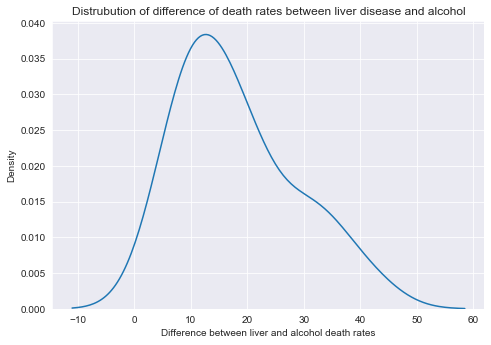

In [28]:
#plot differences
fig = plt.figure()
axes = fig.add_axes([0,0,1,1])
sns.kdeplot(wine_data_diff)
axes.set_xlabel('Difference between liver and alcohol death rates')
axes.set_title('Distrubution of difference of death rates between liver disease and alcohol')
plt.show()

Evaluation of Assumptions:
- The difference between liver and alcohol death rates is an continuous interval variable so the assumption of at minimum ordinality is met
- The samples are independent, meaning the difference in death rates from one country does not inform on the difference in death rates from another
- There is a natural pairing in the data, meaning each country measures a liver death rate and alcohol death rate
- There appears to be a deviation from symmetry

**Missing Context: alcohol and liver death rates should be measured on the same scale for their differences to be valid (per x number of people for example)**

### 4a sample answer.

Assumptions for paired t test:
- Independent samples
- Naturally paired data that is measured on the same scale
- Difference of scores must be normally distributed unless the sample size is sufficiently large such that CLT applies

In [29]:
religion_data = pd.read_csv('datasets/GSS_religion.csv',index_col=0) #Read in religion data
religion_data

,year,id,prottemp,cathtemp
1,2004,4,50,50
2,2004,7,5,85
3,2004,9,50,50
4,2004,14,60,60
5,2004,21,100,0
...,...,...,...,...
798,2004,2800,50,40
799,2004,2803,80,50
800,2004,2805,50,50
801,2004,2806,100,100


In [30]:
religion_data = religion_data[['prottemp','cathtemp']] #keep "feeling temperature"
religion_data['difference'] = religion_data['prottemp'] - religion_data['cathtemp'] #get difference between protestant and catholic temperature
religion_data

<ipython-input-30-0c23b1b8d9b8>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  religion_data['difference'] = religion_data['prottemp'] - religion_data['cathtemp'] #get difference between protestant and catholic temperature


,prottemp,cathtemp,difference
1,50,50,0
2,5,85,-80
3,50,50,0
4,60,60,0
5,100,0,100
...,...,...,...
798,50,40,10
799,80,50,30
800,50,50,0
801,100,100,0


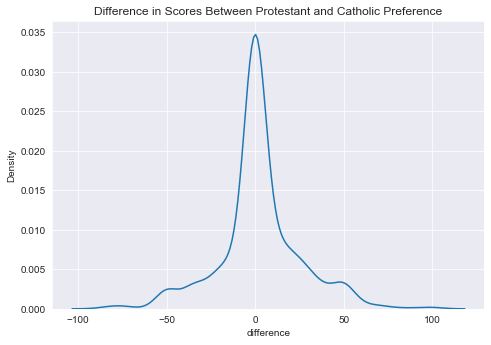

In [31]:
#plot feeling difference of scores
fig = plt.figure()
axes = fig.add_axes([0,0,1,1])
sns.kdeplot(religion_data['difference'])
axes.set_title('Difference in Scores Between Protestant and Catholic Preference')
plt.show()

Evaluation of Assumptions
- This case meets the assumption of independent samples in the event that the population was randomly sampled
- This case meets the assumption of naturally paired data because both religious preferences can be measured for a given individual. In addition, by the initial condition both measurements are taken across the same "feeling temperature" scale
- By the plot above, there appears to be a deviation from normality in the distribution but a large sample of 802 indicates that CLT will allow the distribution of the sample mean to be approximately normal

**Missing Context: Were respondants/samples gathered in a randomized manner**

## Part 2 Statistical Analysis

In [32]:
voter_data = pd.read_csv('datasets/anes_timeseries_2020_csv_20210719.csv') # Read in data
voter_data

C:\Users\AGatt\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3165: DtypeWarning: Columns (15,17,18,19,21,22,23,25,26,27,29,30,31,33,34,35,37,38,1508,1509) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,version,V200001,V160001_orig,V200002,V200003,V200004,V200005,V200006,V200007,V200008,...,V203518,V203519,V203520,V203521,V203522,V203523,V203524,V203525,V203526,V203527
0,ANES2020TimeSeries_20210719,200015,401318,3,2,3,0,-2,-2,-2,...,Thomas Jeffery 'Tom' Cole,1,-1. Inapplicable,-1,-1,82,-1. Inapplicable,-1,-1. Inapplicable,-1
1,ANES2020TimeSeries_20210719,200022,300261,3,2,3,0,4,-1,3,...,Michael Keith 'Mike' Simpson,1,-1. Inapplicable,-1,-1,-1,-1. Inapplicable,-1,-1. Inapplicable,-1
2,ANES2020TimeSeries_20210719,200039,400181,3,2,3,0,-2,-2,-2,...,Scott William Taylor,1,-1. Inapplicable,-1,-1,81,-1. Inapplicable,-1,-1. Inapplicable,-1
3,ANES2020TimeSeries_20210719,200046,300171,3,2,3,0,-2,-2,-2,...,Devin Gerald Nunes,1,-1. Inapplicable,-1,-1,81,-1. Inapplicable,-1,-1. Inapplicable,-1
4,ANES2020TimeSeries_20210719,200053,405145,3,2,3,1,-2,-2,-2,...,Kenneth R. 'Ken' Buck,1,-1. Inapplicable,-1,-1,81,-1. Inapplicable,-1,-1. Inapplicable,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8275,ANES2020TimeSeries_20210719,535315,-1,1,6,3,0,-2,-2,-2,...,Neal Patrick Dunn,1,-1. Inapplicable,-1,-1,82,-1. Inapplicable,-1,-1. Inapplicable,-1
8276,ANES2020TimeSeries_20210719,535360,-1,1,6,3,0,1,1,1,...,Michael Keith 'Mike' Simpson,1,-1. Inapplicable,-1,-1,-1,-1. Inapplicable,-1,-1. Inapplicable,-1
8277,ANES2020TimeSeries_20210719,535414,-1,2,6,3,0,-2,-2,-2,...,Kenneth S. 'Ken' Calvert,1,-1. Inapplicable,-1,-1,81,-1. Inapplicable,-1,-1. Inapplicable,-1
8278,ANES2020TimeSeries_20210719,535421,-1,3,6,3,0,-2,-2,-2,...,Robert J. 'Rob' Wittman,1,-1. Inapplicable,-1,-1,81,-1. Inapplicable,-1,-1. Inapplicable,-1


### Tres initial analysis of suitable variables for identifying R vs D, and target variables
- V201018: PARTY OF REGISTRATION:
        - 3197 R/D
        - 1029 Independent/None
- V201231x Party ID:
        - 8245 valid results (R/D/Ind)
        - So this is the variable I think would be good to use – I think I mixed this one up with party registration when we spoke earlier.  This is also a Likert variable (strong D, not strong D, independent D and vice versa with republican plus a single independent option). I think we could make an argument that your self-identification is more applicable to voting behavior than party registration (not sure how hard of an argument that is to make…or if it is actually valid, would need to do some research).  But that is an option.
- V201228 DOES R THINK OF SELF AS DEMOCRAT, REPUBLICAN, OR INDEPENDENT:
        - 5428 R/D
        - 2527 Independent
- V201230 NO PARTY IDENTIFICATION - CLOSER TO DEMOCRATIC PARTY OR REPUBLICAN PARTY:
        - 1855 R/D
- V202119: HOW DIFFICULT WAS IT FOR R TO VOTE:
        - Likert variable (not difficult = 1 -> extremely difficult = 5)
        - 6401 valid results
        - I think this is the “dependent” variable we should use.  We have a high amount of responses so no issues with sample size
- V202443: WHICH PARTY DOES R FEEL CLOSEST TO:
        - 5810 valid results (R/D)


In [33]:
voter_data = voter_data[['V201231x','V201230','V201228','V202119']] #keep party identification and voter difficulty columns
voter_data.columns = ['Party ID','Party Lean','Party Self ID','Voting Difficulty'] #rename columns
voter_data

,Party ID,Party Lean,Party Self ID,Voting Difficulty
0,7,-1,2,-1
1,4,2,5,1
2,3,3,3,2
3,6,-1,2,1
4,4,2,3,2
...,...,...,...,...
8275,7,-1,2,-1
8276,6,-1,2,1
8277,1,-1,1,2
8278,7,-1,2,1


In [34]:
voter_data['Voting Difficulty'] = voter_data['Voting Difficulty'].apply(lambda x:x if x in [1,2,3,4,5] else np.nan)
#The code above extracts true responses from voting difficulty data. If the response was scored on the 1-5 Likert Scale,
#then the data is unmodified, if it is not scored then we store a null value that will be cleaned out
voter_data = voter_data[voter_data['Voting Difficulty'].isnull() == False] #Keep only data w/ valid response
voter_data

<ipython-input-34-a72511a9c675>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  voter_data['Voting Difficulty'] = voter_data['Voting Difficulty'].apply(lambda x:x if x in [1,2,3,4,5] else np.nan)


,Party ID,Party Lean,Party Self ID,Voting Difficulty
1,4,2,5,1.0
2,3,3,3,2.0
3,6,-1,2,1.0
4,4,2,3,2.0
5,3,3,3,2.0
...,...,...,...,...
8274,7,-1,2,1.0
8276,6,-1,2,1.0
8277,1,-1,1,2.0
8278,7,-1,2,1.0


In [35]:
voter_data['Party ID'] = voter_data['Party ID'].apply(lambda x:'D' if x in [1,2,3] else 'Ind' if x == 4 else 'R' if x
                                                     in [5,6,7] else 'N/A')
#The code above modifies the party ID column to be on a R/D/Ind/NA Scale where the specific scale can be given by
# -9. Refused
#-8. Don’t know
#1. Strong Democrat
#2. Not very strong Democrat
#3. Independent-Democrat
#4. Independent
#5. Independent-Republican
#6. Not very strong Republican
#7. Strong Republican

voter_data['Party Lean'] = voter_data['Party Lean'].apply(lambda x:'R' if x == 1 else 'Ind' if x == 2 
                                                          else 'D' if x == 3 else 'N/A')
#The code above modifies the party lean column to store R/D/Ind/NA if party lean is 1,2,3,other respectively where the
#specified scale can be given by
#-9. Refused
#-8. Don’t know
#-1. Inapplicable
#1. Closer to Republican
#2. Neither {VOL in video and phone}
#3. Closer to Democratic

voter_data['Party Self ID'] = voter_data['Party Self ID'].apply(lambda x:'D' if x == 1 else 'R' if x == 2 else
                                                               'Ind' if x == 3 else 'N/A')
#The code above specifies D/R/Ind/NA if party self id is 1,2,3,other respectively where the specified scale can be given by
#-9. Refused
#-8. Don’t know
#-4. Technical error
#0. No preference {VOL - video/phone only}
#1. Democrat
#2. Republican
#3. Independent
#5. Other party {SPECIFY}

voter_data

<ipython-input-35-eab5534ed9dc>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  voter_data['Party ID'] = voter_data['Party ID'].apply(lambda x:'D' if x in [1,2,3] else 'Ind' if x == 4 else 'R' if x
<ipython-input-35-eab5534ed9dc>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  voter_data['Party Lean'] = voter_data['Party Lean'].apply(lambda x:'R' if x == 1 else 'Ind' if x == 2
<ipython-input-35-eab5534ed9dc>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

,Party ID,Party Lean,Party Self ID,Voting Difficulty
1,Ind,Ind,N/A,1.0
2,D,D,Ind,2.0
3,R,N/A,R,1.0
4,Ind,Ind,Ind,2.0
5,D,D,Ind,2.0
...,...,...,...,...
8274,R,N/A,R,1.0
8276,R,N/A,R,1.0
8277,D,N/A,D,2.0
8278,R,N/A,R,1.0


In [36]:
#Final Party Classification Logic: Tree based Logic
#If party ID == 'D' or 'R' this is final classification
#elif party lean == 'D' or 'R' this is final classification
#elif party self id == 'D' or 'R' this is final classication
#else final classification is 'Ind/NA'

voter_data['Party Classification'] = voter_data.apply(lambda x:x['Party ID'] if x['Party ID'] in ['D','R']
                                                      else x['Party Lean'] if x['Party Lean'] in ['D','R']
                                                      else x['Party Self ID'],axis=1)
voter_data

<ipython-input-36-335515e2c02a>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  voter_data['Party Classification'] = voter_data.apply(lambda x:x['Party ID'] if x['Party ID'] in ['D','R']


,Party ID,Party Lean,Party Self ID,Voting Difficulty,Party Classification
1,Ind,Ind,N/A,1.0,N/A
2,D,D,Ind,2.0,D
3,R,N/A,R,1.0,R
4,Ind,Ind,Ind,2.0,Ind
5,D,D,Ind,2.0,D
...,...,...,...,...,...
8274,R,N/A,R,1.0,R
8276,R,N/A,R,1.0,R
8277,D,N/A,D,2.0,D
8278,R,N/A,R,1.0,R


In [37]:
voter_data['Party Classification'].value_counts()
# With this tree based classification scheme, of the 6401 valid likert scale responses for voter difficulty we are
#able to preserve 5831 observations which is ~91.1% of the valid response data

D      3131
R      2700
Ind     502
N/A      68
Name: Party Classification, dtype: int64

In [38]:
voter_data = voter_data[(voter_data['Party Classification'] == 'D') | (voter_data['Party Classification'] == 'R')]
#Keep only D/R final party classifcations
voter_data = voter_data[['Party Classification','Voting Difficulty']]
#Keep party classification and voting difficulty data
voter_data

,Party Classification,Voting Difficulty
2,D,2.0
3,R,1.0
5,D,2.0
6,R,1.0
9,D,2.0
...,...,...
8274,R,1.0
8276,R,1.0
8277,D,2.0
8278,R,1.0


In [39]:
dem_data = voter_data[voter_data['Party Classification'] == 'D'] #Democrat Data
rep_data = voter_data[voter_data['Party Classification'] == 'R'] #Republican Data

In [40]:
dem_data

,Party Classification,Voting Difficulty
2,D,2.0
5,D,2.0
9,D,2.0
10,D,1.0
11,D,1.0
...,...,...
8269,D,1.0
8270,D,2.0
8272,D,1.0
8277,D,2.0


In [41]:
rep_data

,Party Classification,Voting Difficulty
3,R,1.0
6,R,1.0
12,R,1.0
23,R,1.0
26,R,1.0
...,...,...
8268,R,2.0
8273,R,1.0
8274,R,1.0
8276,R,1.0


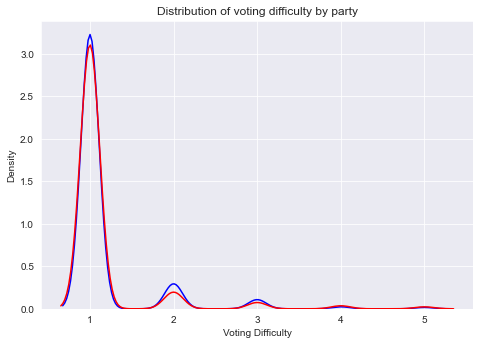

In [42]:
fig = plt.figure()
axes = fig.add_axes([0,0,1,1])
sns.kdeplot(dem_data['Voting Difficulty'],color='blue')
sns.kdeplot(rep_data['Voting Difficulty'],color='red')
axes.set_title('Distribution of voting difficulty by party')
plt.show()

### Hypothesis Test Selection:
Our goal is to evaluate whether democratic or republican voters experience more voting difficulty. Upon analyzing the data, our reponse variable **Voting Difficulty** is an ordinal variable measured on a Likert Scale from 1-5 where 1 signifies less difficulty while 5 signifies more difficulty. Ordinal data results in the need for a **non-parametric test**. Additionally, we are comparing between two distinct groups without a natural pairing, **so a paired test is ruled out**. The samples here are independent as the perception of voting difficulty for one respondent does not inform on another's response. Finally, upon evaluating the response variable density across party lines, voting difficulty has a similar distribution in both cases. Therefore, the characteristics listed above meet the assumptions for a **Wilcoxon Rank Sum Test**.

In [43]:
sp.stats.ranksums(dem_data['Voting Difficulty'],rep_data['Voting Difficulty'])
#Wilcoxon Rank Sum Two Tailed Test. Null is voter difficulty is equal, alternative is voter difficulty is not equal

RanksumsResult(statistic=1.5692795128802761, pvalue=0.11658282386616511)

In [44]:
sp.stats.ranksums(dem_data['Voting Difficulty'],rep_data['Voting Difficulty'],alternative='greater')
#Wilcoxon Rank Sum One Tailed Test. Null is voter difficulty is equal, alternative is dem voter difficulty is greater

RanksumsResult(statistic=1.5692795128802761, pvalue=0.05829141193308256)

In [45]:
sp.stats.ranksums(dem_data['Voting Difficulty'],rep_data['Voting Difficulty'],alternative='less')
#Wilcoxon Rank Sum One Tailed Test. Null is voter difficulty is equal, alternative is dem voter difficulty is less

RanksumsResult(statistic=1.5692795128802761, pvalue=0.9417085880669175)